<a href="https://colab.research.google.com/github/Bychare/drone-vs-bird-fastapi/blob/main/drone_vs_bird.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# === Шаг 1: Установка и настройка Kaggle ===
import pandas as pd
import numpy as np
!pip install -q kaggle
!pip install utils

  Preparing metadata (setup.py) ... done
  Created wheel for utils: filename=utils-1.0.2-py2.py3-none-any.whl size=13906 sha256=3d770792ea04f99de70a7edab441c6d2add473f7f02f01ea5951bdf862c27eb6
  Stored in directory: /root/.cache/pip/wheels/15/0c/b3/674aea8c5d91c642c817d4d630bd58faa316724b136844094d
Successfully built utils


In [20]:
from ultralytics import YOLO
from IPython.display import Image as IPImage, display
import os
import shutil
import random
import cv2
from PIL import Image
from glob import glob
import matplotlib.pyplot as plt
import imageio.v2 as imageio

In [3]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [4]:
# Скачиваем датасет и распаковываем
!kaggle datasets download -d stealthknight/bird-vs-drone
!unzip bird-vs-drone.zip -d bird_vs_drone
!ls bird_vs_drone

Выходные данные были обрезаны до нескольких последних строк (5000).
  inflating: bird_vs_drone/Dataset/train/labels/DTR (8631).txt  
  inflating: bird_vs_drone/Dataset/train/labels/DTR (8632).txt  
  inflating: bird_vs_drone/Dataset/train/labels/DTR (8633).txt  
  inflating: bird_vs_drone/Dataset/train/labels/DTR (8634).txt  
  inflating: bird_vs_drone/Dataset/train/labels/DTR (8635).txt  
  inflating: bird_vs_drone/Dataset/train/labels/DTR (8636).txt  
  inflating: bird_vs_drone/Dataset/train/labels/DTR (8637).txt  
  inflating: bird_vs_drone/Dataset/train/labels/DTR (8638).txt  
  inflating: bird_vs_drone/Dataset/train/labels/DTR (8639).txt  
  inflating: bird_vs_drone/Dataset/train/labels/DTR (864).txt  
  inflating: bird_vs_drone/Dataset/train/labels/DTR (8640).txt  
  inflating: bird_vs_drone/Dataset/train/labels/DTR (8641).txt  
  inflating: bird_vs_drone/Dataset/train/labels/DTR (8642).txt  
  inflating: bird_vs_drone/Dataset/train/labels/DTR (8643).txt  
  inflating: bird_vs_dr

In [17]:
# --- Блок 3: Подготовка подмножества данных ---
def copy_random_images(source, dest, n):
    os.makedirs(dest, exist_ok=True)
    files = [f for f in os.listdir(source) if f.endswith(('.jpg', '.jpeg', '.png'))]
    for f in random.sample(files, n):
        shutil.copy(os.path.join(source, f), os.path.join(dest, f))

copy_random_images("bird_vs_drone/Dataset/train/images", "images", 50)

In [18]:
# --- Блок 4: Предсказания YOLO ---
model = YOLO("yolov8x.pt")
results = model.predict("images")

BOX = pd.DataFrame(columns=range(6))
for i in range(len(results)):
    boxes = pd.DataFrame(results[i].boxes.data).astype(float)
    boxes['i'] = i
    BOX = pd.concat([BOX, boxes])

BOX.columns = ['x1', 'y1', 'x2', 'y2', 'confidence', 'class', 'i']
BOX = BOX.reset_index(drop=True)

class_map = model.model.names
BOX['class_name'] = BOX['class'].apply(lambda x: class_map[int(x)])


image 1/150 /content/images/BTR (1138).jpg: 640x640 1 person, 1 surfboard, 6483.5ms
image 2/150 /content/images/BTR (1465).jpg: 640x640 1 person, 4553.0ms
image 3/150 /content/images/BTR (1521).jpg: 640x640 2 birds, 1 umbrella, 10873.5ms
image 4/150 /content/images/BTR (1522).jpg: 640x640 1 person, 1 bird, 1 broccoli, 4613.1ms
image 5/150 /content/images/BTR (1631).jpg: 640x640 (no detections), 5328.9ms
image 6/150 /content/images/BTR (1770).jpg: 640x640 2 birds, 4754.2ms
image 7/150 /content/images/BTR (2122).jpg: 640x640 1 bird, 1 sheep, 1 bear, 4547.3ms
image 8/150 /content/images/BTR (2323).jpg: 640x640 2 birds, 5621.3ms
image 9/150 /content/images/BTR (234).jpg: 640x640 1 umbrella, 4520.8ms
image 10/150 /content/images/BTR (2355).jpg: 640x640 1 person, 1 bird, 1 bed, 4746.2ms
image 11/150 /content/images/BTR (2447).jpg: 640x640 2 birds, 5341.4ms
image 12/150 /content/images/BTR (2559).jpg: 640x640 (no detections), 4546.7ms
image 13/150 /content/images/BTR (2563).jpg: 640x640 2 st

<ipython-input-18-f906be8c4663>:9: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  BOX = pd.concat([BOX, boxes])


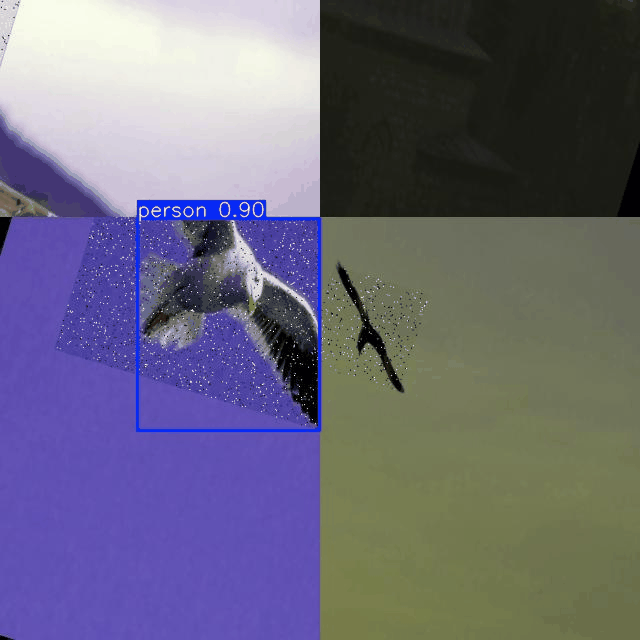

In [21]:
# --- Блок 5: Анимация ---
from IPython.display import HTML
imgs = [plt.imread(p) for p in sorted(glob('runs/detect/predict/*.jpg'))]
imageio.mimsave('animated.gif', imgs, duration=1)
display(IPImage('animated.gif'))


In [24]:
!pip install pyngrok

In [25]:
# --- Блок 6: FastAPI ---
from fastapi import FastAPI, UploadFile, File
from fastapi.responses import JSONResponse
import nest_asyncio
from pyngrok import ngrok
import uvicorn

app = FastAPI()
model = YOLO("yolov8x.pt")

@app.post("/predict")
async def predict(file: UploadFile = File(...)):
    contents = await file.read()
    nparr = np.frombuffer(contents, np.uint8)
    img = cv2.imdecode(nparr, cv2.IMREAD_COLOR)
    results = model.predict(img)[0]

    output = []
    for box in results.boxes.data:
        x1, y1, x2, y2, conf, cls = box.tolist()
        output.append({
            "bbox": [x1, y1, x2, y2],
            "confidence": conf,
            "class": class_map[int(cls)]
        })
    return JSONResponse(content={"predictions": output})

In [32]:
from fastapi import FastAPI, UploadFile, File, Request
from fastapi.responses import HTMLResponse, FileResponse
from fastapi.staticfiles import StaticFiles
from PIL import Image
import shutil
import os
import uuid
import matplotlib.pyplot as plt

app = FastAPI()

# Статические файлы (для изображений)
os.makedirs("static", exist_ok=True)
app.mount("/static", StaticFiles(directory="static"), name="static")

# Главная страница
@app.get("/", response_class=HTMLResponse)
async def read_root():
    return """
    <html>
        <head>
            <title>Drone vs Bird Detection</title>
        </head>
        <body style="font-family: Arial; text-align: center; margin-top: 50px;">
            <h1>🚁 Drone vs 🐦 Bird Detector</h1>
            <p>Отправьте изображение и получите предсказания!</p>
            <a href="/upload/">📤 Загрузить изображение</a>
        </body>
    </html>
    """

# HTML-форма загрузки изображения
@app.get("/upload/", response_class=HTMLResponse)
async def upload_form():
    return """
    <html>
        <head><title>Загрузка изображения</title></head>
        <body style="font-family: Arial; text-align: center; margin-top: 50px;">
            <h2>📷 Загрузите изображение для предсказания</h2>
            <form action="/predict/" enctype="multipart/form-data" method="post">
                <input name="file" type="file" accept="image/*">
                <input type="submit" value="Предсказать">
            </form>
            <br>
            <a href="/">← Назад</a>
        </body>
    </html>
    """

# Предсказание и визуализация результата
@app.post("/predict/", response_class=HTMLResponse)
async def predict_image(file: UploadFile = File(...)):
    # Уникальное имя файла
    file_id = str(uuid.uuid4())
    input_path = f"static/{file_id}.jpg"
    output_path = f"static/{file_id}_result.jpg"

    # Сохраняем файл
    with open(input_path, "wb") as buffer:
        shutil.copyfileobj(file.file, buffer)

    # Предсказание
    results = model(input_path)

    # Сохраняем визуализацию
    results[0].save(filename=output_path)

    return f"""
    <html>
        <head><title>Результат</title></head>
        <body style="font-family: Arial; text-align: center; margin-top: 30px;">
            <h2>🔍 Предсказание YOLOv8</h2>
            <img src="/{output_path}" alt="Result" style="max-width: 80%; border: 1px solid #ccc;" />
            <p><a href="/upload/">Попробовать ещё</a></p>
        </body>
    </html>
    """




In [33]:
from pyngrok import conf
import os
conf.get_default().auth_token = os.getenv("NGROK_TOKEN")

In [34]:
# --- Блок 7: Ngrok ---
nest_asyncio.apply()
public_url = ngrok.connect(8000)
print("Ваш публичный URL:", public_url)
uvicorn.run(app, port=8000)

Ваш публичный URL: NgrokTunnel: "https://2841-34-105-125-239.ngrok-free.app" -> "http://localhost:8000"


INFO:     Started server process [174]
INFO:     Waiting for application startup.
INFO:     Application startup complete.
INFO:     Uvicorn running on http://127.0.0.1:8000 (Press CTRL+C to quit)


INFO:     217.144.102.42:0 - "GET / HTTP/1.1" 200 OK
INFO:     217.144.102.42:0 - "GET /favicon.ico HTTP/1.1" 404 Not Found
INFO:     217.144.102.42:0 - "GET /upload/ HTTP/1.1" 200 OK

image 1/1 /content/static/d8b4b24f-98fc-4403-9de0-e126b9218633.jpg: 640x640 1 bird, 5261.4ms
Speed: 9.1ms preprocess, 5261.4ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)
INFO:     217.144.102.42:0 - "POST /predict/ HTTP/1.1" 200 OK
INFO:     217.144.102.42:0 - "GET /static/d8b4b24f-98fc-4403-9de0-e126b9218633_result.jpg HTTP/1.1" 200 OK
INFO:     217.144.102.42:0 - "GET /upload/ HTTP/1.1" 200 OK

image 1/1 /content/static/9b7923f2-3b68-4c1a-9e67-61f315797370.jpg: 640x640 1 airplane, 4666.5ms
Speed: 3.3ms preprocess, 4666.5ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)
INFO:     217.144.102.42:0 - "POST /predict/ HTTP/1.1" 200 OK
INFO:     217.144.102.42:0 - "GET /static/9b7923f2-3b68-4c1a-9e67-61f315797370_result.jpg HTTP/1.1" 200 OK


INFO:     Shutting down
INFO:     Waiting for application shutdown.
INFO:     Application shutdown complete.
INFO:     Finished server process [174]
